In [ ]:
import json
import cv2
import numpy as np
from ultralytics import YOLO


class DetSegModel:
    def __init__(self, detection_model_path, meat_seg_path, fruit_seg_path, vege_seg_path,
                dairy_seg_path, nuts_seg_path, grains_seg_path, sweets_seg_path, misc_seg_path, seg_classes_path,
                seg_dict_path=None, idx_to_name_path=None):
        
        self.det_model = YOLO(detection_model_path)

        self.seg_models = {
            "meat": YOLO(meat_seg_path),
            "fruit": YOLO(fruit_seg_path),
            "vegetables": YOLO(vege_seg_path),
            "cheese-dairy": YOLO(dairy_seg_path),
            "nuts-seeds": YOLO(nuts_seg_path),
            "bread-pasta-grains": YOLO(grains_seg_path),
            "sweets-desserts": YOLO(sweets_seg_path),
            "miscellaneous": YOLO(misc_seg_path),
        }

        with open(seg_classes_path, "r") as f:
            self.seg_classes = json.load(f)

        with open(seg_dict_path, "r") as f:
            self.det_to_seg_group = json.load(f)

        if idx_to_name_path:
            with open(idx_to_name_path, "r") as f:
                self.idx_to_name = json.load(f)

    def _expand_bbox(self, bbox, image_shape, scale=1.1):
        x1, y1, x2, y2 = bbox
        w, h = x2 - x1, y2 - y1
        cx, cy = x1 + w / 2, y1 + h / 2
        new_w, new_h = w * scale, h * scale

        x1n = max(0, int(cx - new_w / 2))
        y1n = max(0, int(cy - new_h / 2))
        x2n = min(image_shape[1] - 1, int(cx + new_w / 2))
        y2n = min(image_shape[0] - 1, int(cy + new_h / 2))

        return [x1n, y1n, x2n, y2n]
    

    def run(self, image_path, conf_thresh=0.25, mask_conf_thresh=0.5, det_imgsz=800, vis=True, vis_crops=False, seg_first=False):
        image = cv2.imread(image_path)
        if image is None:
            raise FileNotFoundError(f"Image not found: {image_path}")

        vis_img = image.copy() if vis else None

        def _show_mask_overlay(base_img, mask, title=None, color=None):
            overlay = base_img.copy()
            if color is None:
                color = tuple(np.random.randint(0, 256, 3).tolist())
            # apply color with alpha
            alpha = 0.5
            colored_mask = np.zeros_like(overlay, dtype=np.uint8)
            colored_mask[mask > 0] = color
            cv2.addWeighted(colored_mask, alpha, overlay, 1 - alpha, 0, overlay)
            if title:
                import matplotlib.pyplot as plt
                plt.figure(figsize=(6,6))
                plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
                plt.title(title)
                plt.axis("off")
                plt.show()
                
            return overlay

        ### SEGMENTATION FIRST (optional) ###
        if seg_first:
            for seg_group, seg_model in self.seg_models.items():
                seg_result = seg_model.predict(source=image, conf=mask_conf_thresh, verbose=False)[0]

                if seg_result.masks is not None:
                    for j, mask in enumerate(seg_result.masks.data):
                        mask = mask.cpu().numpy()
                        full_mask = (cv2.resize(mask, (image.shape[1], image.shape[0])) > mask_conf_thresh).astype(np.uint8) * 255

                        # --- Get segmentation class + confidence ---
                        seg_cls_id = int(seg_result.boxes.cls[j])
                        seg_cls_conf = float(seg_result.boxes.conf[j])
                        if seg_cls_conf < 0.75:
                            continue  # skip low confidence
                        seg_cls_name = self.seg_classes[seg_group].get(str(seg_cls_id), "unknown")
                        print(f"[{seg_group}] Segmented Class: '{seg_cls_name}' with confidence {seg_cls_conf:.2f}")

                        if vis:
                            color = (0, 255, 0)
                            vis_img[full_mask > 0] = (
                                0.5 * vis_img[full_mask > 0] + 0.5 * np.array(color)
                            ).astype(np.uint8)

                        if vis:
                            title = f"{seg_group} - {seg_cls_name} ({seg_cls_conf:.2f})"
                            _show_mask_overlay(image, full_mask, title=title)

                            
        ### DETECTION ### 
        det_results = self.det_model.predict(source=image, imgsz=det_imgsz, conf=conf_thresh, agnostic_nms=True, save=False, verbose=False)

        all_boxes = []
        final_outputs = []

        for det in det_results:
            boxes = det.boxes.xyxy.cpu().numpy()
            class_ids = det.boxes.cls.cpu().numpy()
            scores = det.boxes.conf.cpu().numpy()

            for i, box in enumerate(boxes):
                x1, y1, x2, y2 = map(int, box)
                det_class_id = int(class_ids[i])
                det_conf_score = float(scores[i])
                det_class_name = self.idx_to_name[str(det_class_id)] if hasattr(self, 'idx_to_name') else str(det_class_id)

                all_boxes.append((x1, y1, x2, y2, det_class_name, det_conf_score))
                
                # --- Find which segmentation model to use ---
                seg_group = None
                for group_name, class_list in self.det_to_seg_group.items():
                    if det_class_name in class_list:
                        seg_group = group_name
                        # print(f"Detected class '{det_class_name}' mapped to segmentation group '{seg_group}'")
                        break

                if seg_group is None:
                    print(f"No segmentation model found for class '{det_class_name}'")
                    seg_found = False

                # --- Expand and crop bounding box from ORIGINAL image ---
                expanded_bbox = self._expand_bbox([x1, y1, x2, y2], image.shape)
                ex1, ey1, ex2, ey2 = expanded_bbox
                crop = image[ey1:ey2, ex1:ex2].copy()

                if vis_crops:
                    if crop.size > 0:
                        import matplotlib.pyplot as plt
                        plt.figure(figsize=(4, 4))
                        plt.imshow(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
                        plt.title(f"Crop: {det_class_name} ({det_conf_score:.2f})")
                        plt.axis('off')
                        plt.show()
                    else:
                        print(f"Skipped empty crop for {det_class_name} at {expanded_bbox}")

                if crop.size == 0:
                    continue  

                # --- Run segmentation only if seg_group found ---
                masks_global = []
                if seg_group in self.seg_models:
                    seg_model = self.seg_models[seg_group]
                    seg_result = seg_model.predict(source=crop, conf=mask_conf_thresh, verbose=False)[0]

                    if seg_result.masks is None:
                        seg_found = False
                    else:
                        seg_found = True

                    if seg_result.masks is not None:
                        for j, mask in enumerate(seg_result.masks.data):
                            mask = mask.cpu().numpy()
                            mask_resized = cv2.resize(mask, (ex2 - ex1, ey2 - ey1))
                            full_mask = np.zeros(image.shape[:2], dtype=np.uint8)
                            full_mask[ey1:ey2, ex1:ex2] = (mask_resized > mask_conf_thresh).astype(np.uint8) * 255
                            masks_global.append(full_mask)

                            # --- Get segmentation class + confidence ---
                            seg_cls_id = int(seg_result.boxes.cls[j])
                            seg_cls_conf = float(seg_result.boxes.conf[j])
                            seg_cls_name = self.seg_classes[seg_group].get(str(seg_cls_id), "unknown")
                            print(f"Detected class: '{det_class_name} ({det_conf_score:.2f})', Segmented Class: '{seg_cls_name}' with confidence {seg_cls_conf:.2f}")

                            # --- Optional visualization overlay ---
                            if vis:
                                color = (0, 255, 0)
                                vis_img[full_mask > 0] = (
                                    0.5 * vis_img[full_mask > 0] + 0.5 * np.array(color)
                                ).astype(np.uint8)

                                # Label background and white text
                                # label_text = f"{seg_cls_name} ({seg_cls_conf:.2f})"
                                # (tw, th), base = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)
                                # text_x, text_y = ex1 + 5, ey1 + 25 + 22 * j
                                # cv2.rectangle(vis_img, (text_x - 2, text_y - th - 4),
                                #             (text_x + tw + 2, text_y + base), (0, 0, 0), -1)
                                # cv2.putText(vis_img, label_text, (text_x, text_y),
                                #             cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2, cv2.LINE_AA)
                                
                # --- Always draw bounding box and label (even if no seg model) ---
                label_text = f"{det_class_name} ({det_conf_score:.2f})"
                (text_w, text_h), baseline = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)
                cv2.rectangle(vis_img, (x1, y1 - text_h - 8), (x1 + text_w + 4, y1), (0, 0, 0), -1)  # solid black background
                cv2.putText(vis_img, label_text, (x1 + 2, y1 - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 255, 255), 2, cv2.LINE_AA)

                box_color = (255, 0, 0) if seg_group else (128, 128, 128)
                cv2.rectangle(vis_img, (x1, y1), (x2, y2), box_color, 2)


                ### more detailed output
                # final_outputs.append({
                #     "det_class": det_class_name,
                #     "bbox": expanded_bbox,
                #     "seg_group": seg_group,
                #     "seg_masks": masks_global,
                #     "score": det_conf_score
                # })
                if seg_found:
                    final_outputs.append((seg_cls_name, seg_cls_conf))
                else:
                    if det_conf_score >= 0.5:
                        final_outputs.append((det_class_name, det_conf_score))


            # print(all_boxes)

        if vis:
            import matplotlib.pyplot as plt
            plt.figure(figsize=(10, 10))
            plt.imshow(cv2.cvtColor(vis_img, cv2.COLOR_BGR2RGB))
            plt.axis("off")
            plt.show()

        return final_outputs

Detected class: 'salmon (0.95)', Segmented Class: 'salmon' with confidence 0.78
Detected class: 'salmon (0.94)', Segmented Class: 'salmon' with confidence 0.80
Detected class: 'green-asparagus (0.30)', Segmented Class: 'green-beans' with confidence 0.30


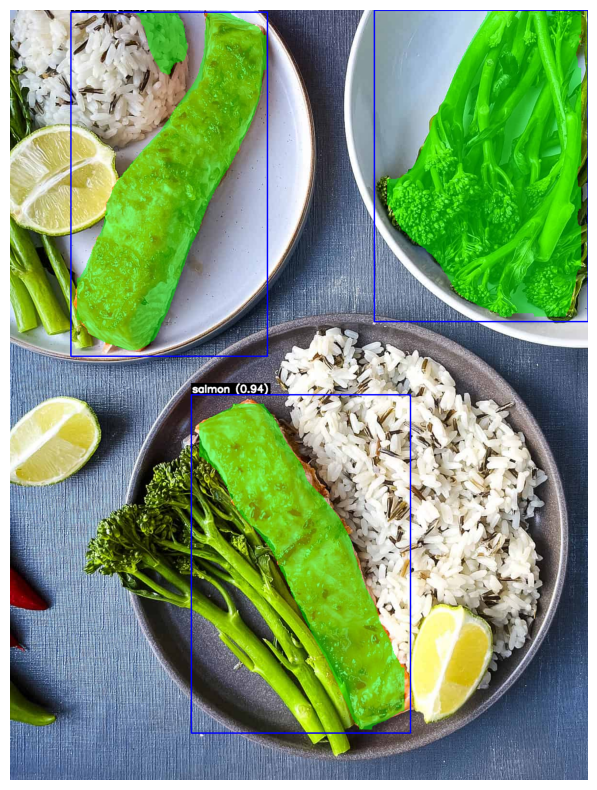

Results:
[('salmon', 0.7757534980773926), ('salmon', 0.7973473072052002), ('green-beans', 0.3041078746318817)]


In [2]:
# det_path = "runs/detect/yolo_det_v4_kornel/weights/best.pt" ### MEDIUM 50 ###
det_path = "runs/detect/yolo_det_v4_m/weights/best.pt" ### MEDIUM 100 ###
# det_path = "runs/detect/yolo_det_v3_kornel/weights/best.pt" ### SMALL 50 ###
# det_path = "runs/detect/yolo_det_v4_s/weights/best.pt" ### SMALL 100 ###


%matplotlib inline
pipeline = DetSegModel(
    detection_model_path=det_path,
    meat_seg_path="seg_models/runs/segment/yolo_seg_meat_v1/weights/best.pt",
    fruit_seg_path="seg_models/runs/segment/yolo_segfruitS_v1/weights/best.pt",
    vege_seg_path="seg_models/runs/segment/yolo_segvegeS_v1/weights/best.pt",
    dairy_seg_path="seg_models/runs/segment/yolo_segdairyS_v1/weights/best.pt",
    nuts_seg_path="seg_models/runs/segment/yolo_nuts-seedsS_v1/weights/best.pt",
    grains_seg_path="seg_models/runs/segment/yolo_seggrainS_v1/weights/best.pt",
    sweets_seg_path="seg_models/runs/segment/yolo_segsweetsS_v1/weights/best.pt",
    misc_seg_path="seg_models/runs/segment/yolo_miscS_v1/weights/best.pt",
    seg_classes_path="seg_classes.json",
    seg_dict_path="segmentation_dict.json",
    idx_to_name_path="detect_classes_v4.json"
)

results = pipeline.run(image_path="test_pics/test.jpg", conf_thresh=0.2, mask_conf_thresh=0.3, vis=True, vis_crops=False, seg_first=False)

print(f"Results:\n{results}")



Processing image: test_pics/dom/610cc69d-8f6a-4e80-962d-427eb4e8efe8.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'kiwi (0.85)', Segmented Class: 'kiwi' with confidence 0.88


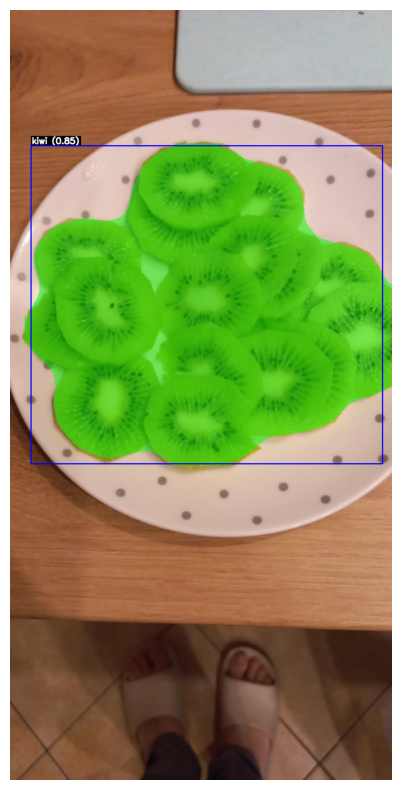

Processing image: test_pics/dom/8883fa71-ec6e-4fc2-bc73-5a43dcd815f5.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'chicken (0.86)', Segmented Class: 'chicken' with confidence 0.60


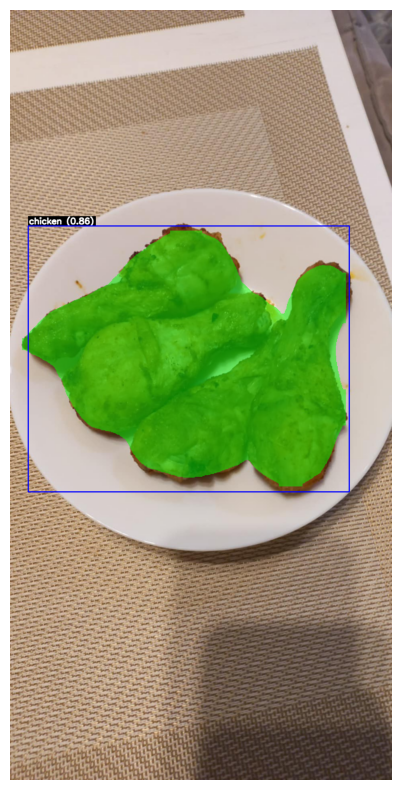

Processing image: test_pics/dom/ae86f72f-03c3-4a44-81f9-f7819400c7d8.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


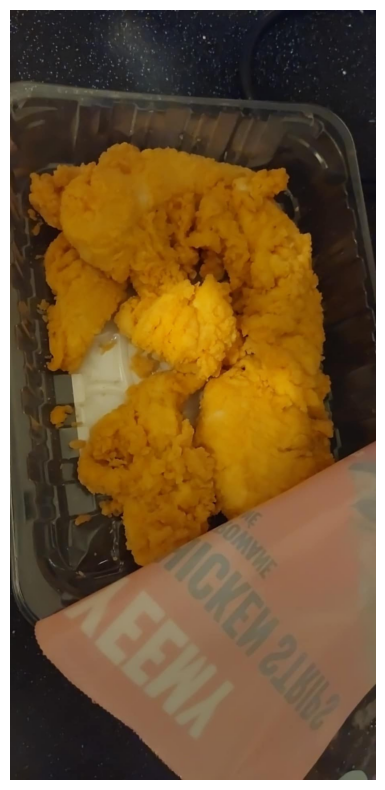

Processing image: test_pics/dom/apple.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'apple (0.97)', Segmented Class: 'apple' with confidence 0.93


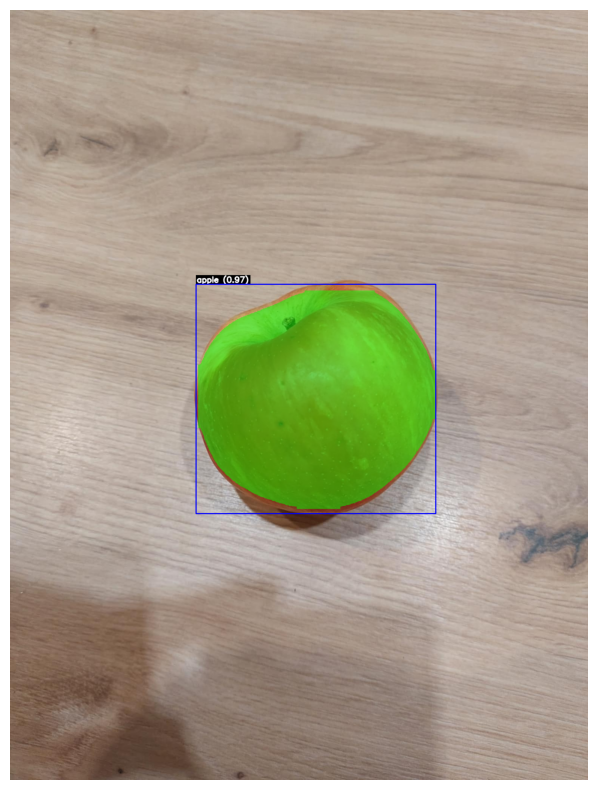

Processing image: test_pics/dom/b70cf4b9-261f-4c66-8ab5-15cefc6de3a1.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'cookies (0.96)', Segmented Class: 'cookies' with confidence 0.88


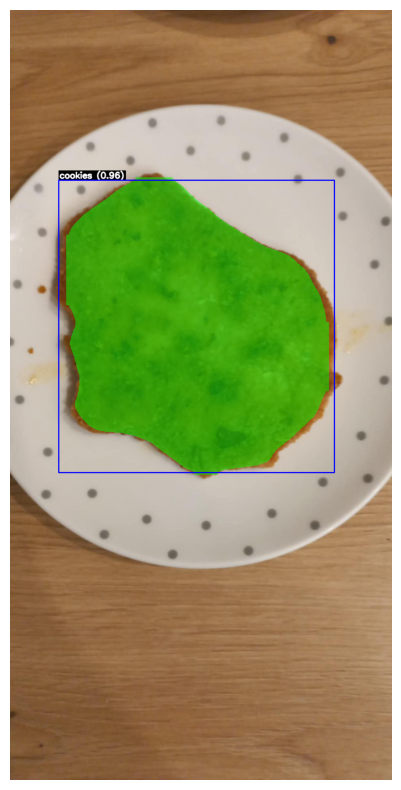

Processing image: test_pics/dom/bread1.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'bread-whole-grain (0.67)', Segmented Class: 'bread-wholemeal' with confidence 0.58


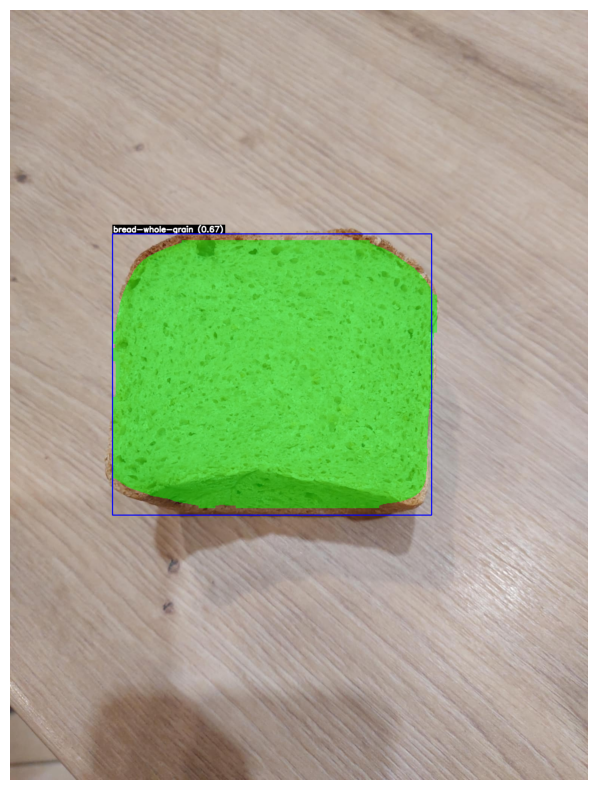

Processing image: test_pics/dom/bread2.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


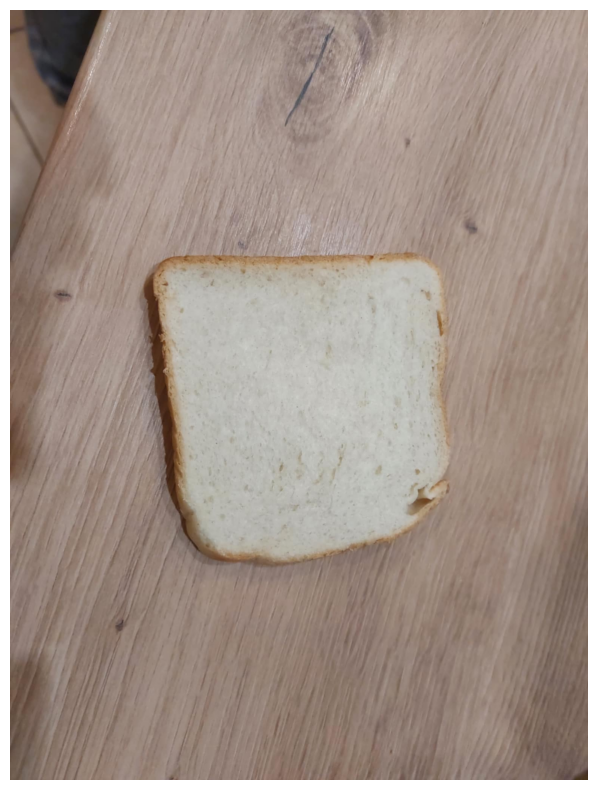

Processing image: test_pics/dom/bread3.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


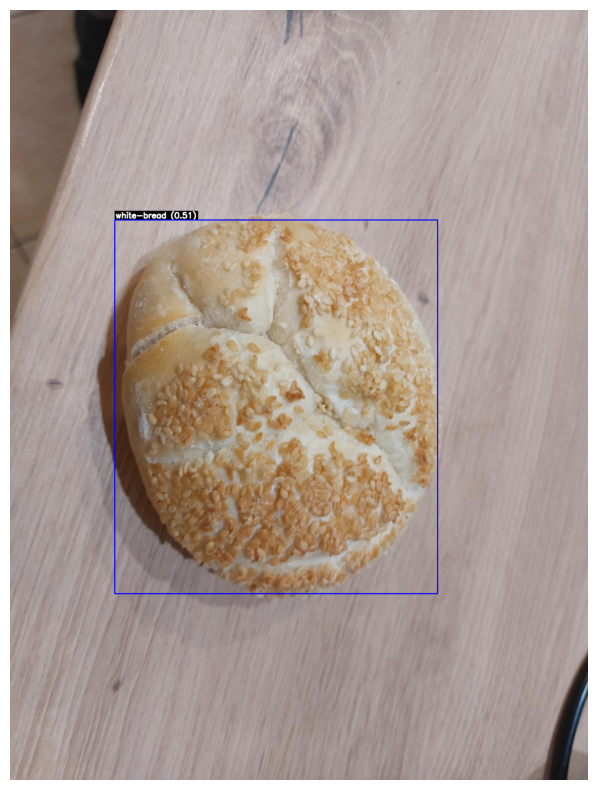

Processing image: test_pics/dom/bread4.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'white-bread (0.69)', Segmented Class: 'bread-white' with confidence 0.89
Detected class: 'white-bread (0.57)', Segmented Class: 'bread-white' with confidence 0.91


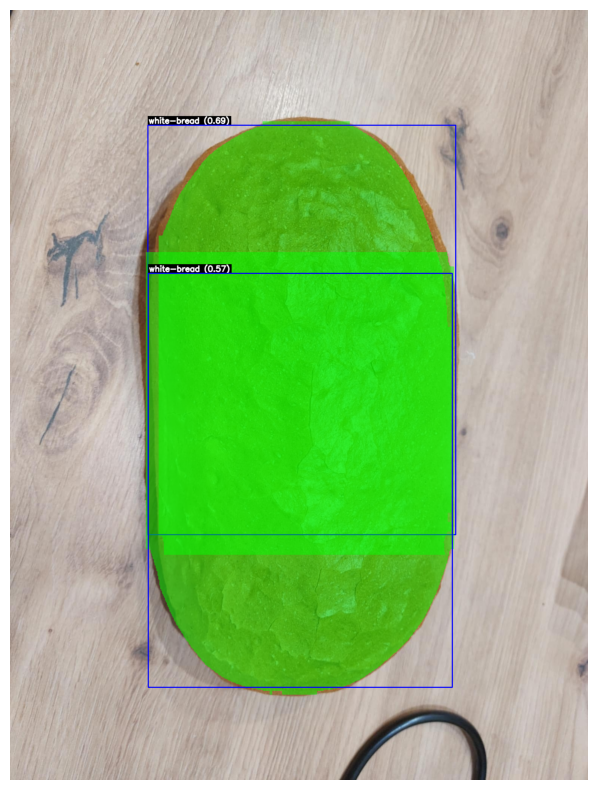

Processing image: test_pics/dom/bread5.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'white-bread (0.82)', Segmented Class: 'bread-white' with confidence 0.78
Detected class: 'white-bread (0.34)', Segmented Class: 'bread-white' with confidence 0.89


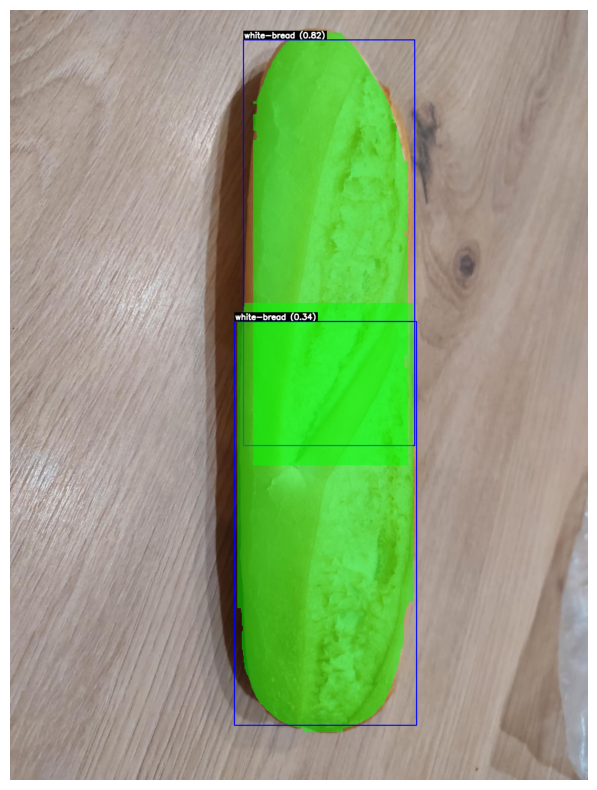

Processing image: test_pics/dom/broccoli.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


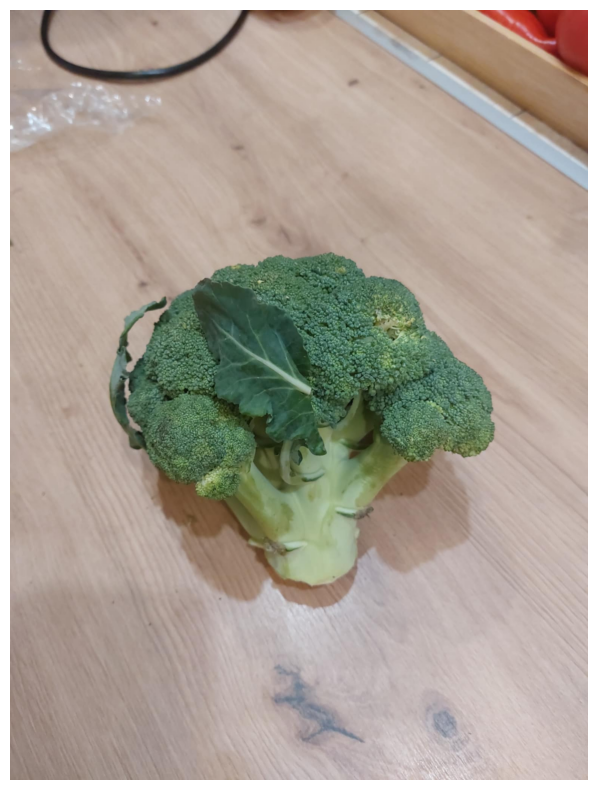

Processing image: test_pics/dom/croissant.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'croissant (0.88)', Segmented Class: 'croissant' with confidence 0.92


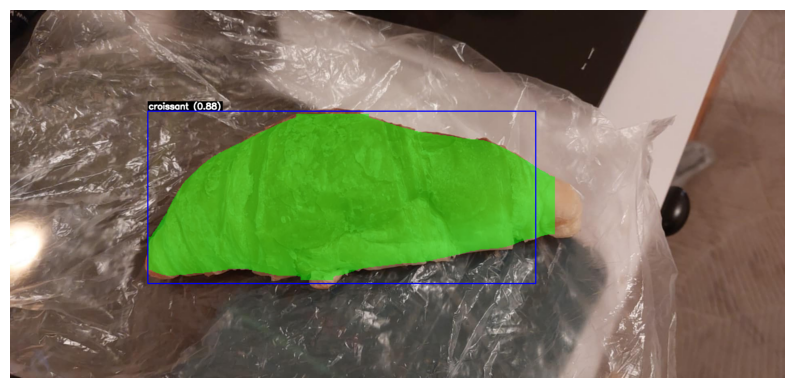

Processing image: test_pics/dom/cucumber1.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'cucumber (0.87)', Segmented Class: 'cucumber' with confidence 0.82


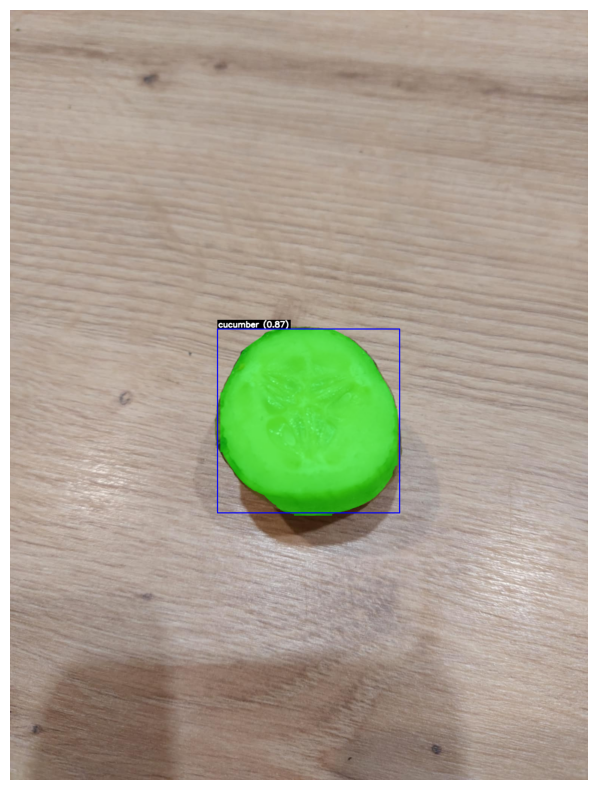

Processing image: test_pics/dom/cucumber2.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


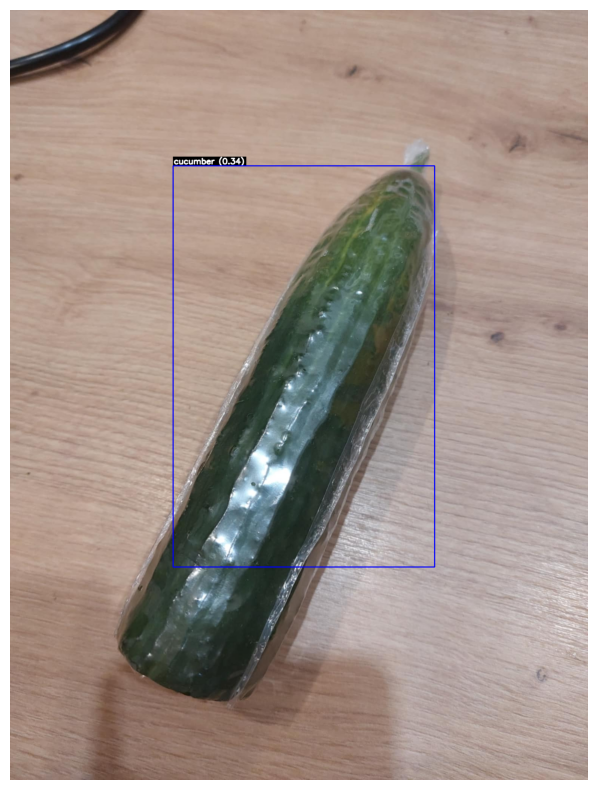

Processing image: test_pics/dom/dom1.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'tomato-raw (0.94)', Segmented Class: 'tomato-raw' with confidence 0.86
Detected class: 'mandarine (0.42)', Segmented Class: 'orange' with confidence 0.92


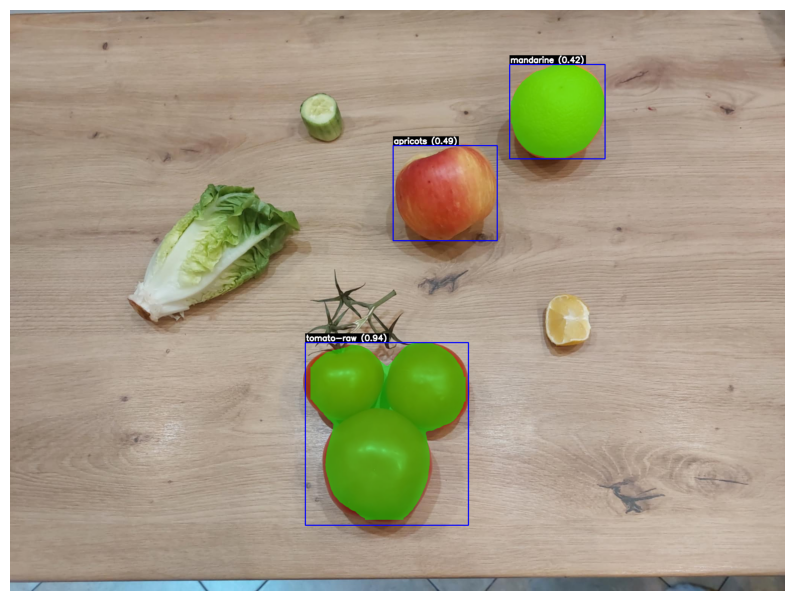

Processing image: test_pics/dom/dom2.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'tomato-raw (0.90)', Segmented Class: 'tomato-raw' with confidence 0.89
Detected class: 'blueberries (0.82)', Segmented Class: 'blueberries' with confidence 0.85
Detected class: 'blueberries (0.82)', Segmented Class: 'apple' with confidence 0.77
Detected class: 'apricots (0.81)', Segmented Class: 'apple' with confidence 0.66
Detected class: 'tomato-raw (0.70)', Segmented Class: 'tomato-raw' with confidence 0.69


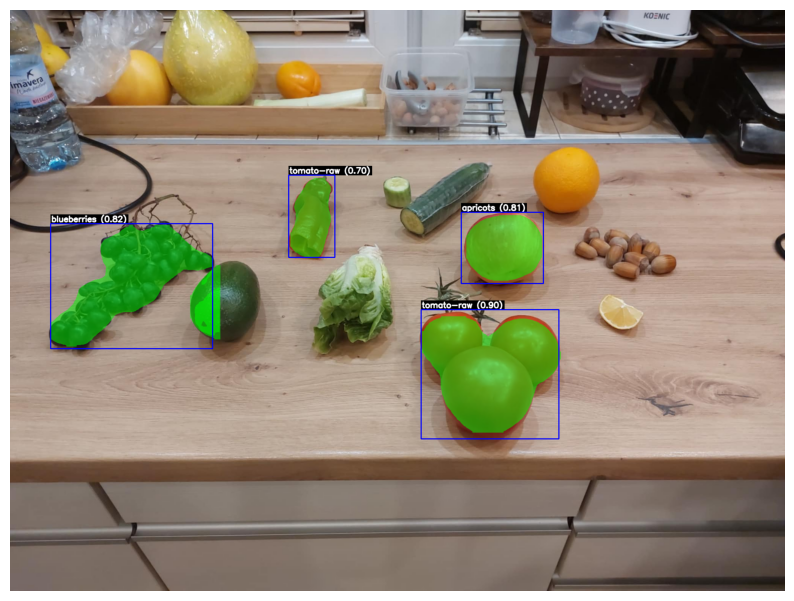

Processing image: test_pics/dom/dom3.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'tomato-raw (0.93)', Segmented Class: 'tomato-raw' with confidence 0.92
Detected class: 'blueberries (0.92)', Segmented Class: 'blueberries' with confidence 0.85
Detected class: 'almonds (0.87)', Segmented Class: 'almonds' with confidence 0.78
Detected class: 'bell-pepper-red-raw (0.75)', Segmented Class: 'tomato-raw' with confidence 0.86
Detected class: 'tomato-raw (0.74)', Segmented Class: 'tomato-raw' with confidence 0.90
Detected class: 'apricots (0.56)', Segmented Class: 'orange' with confidence 0.90


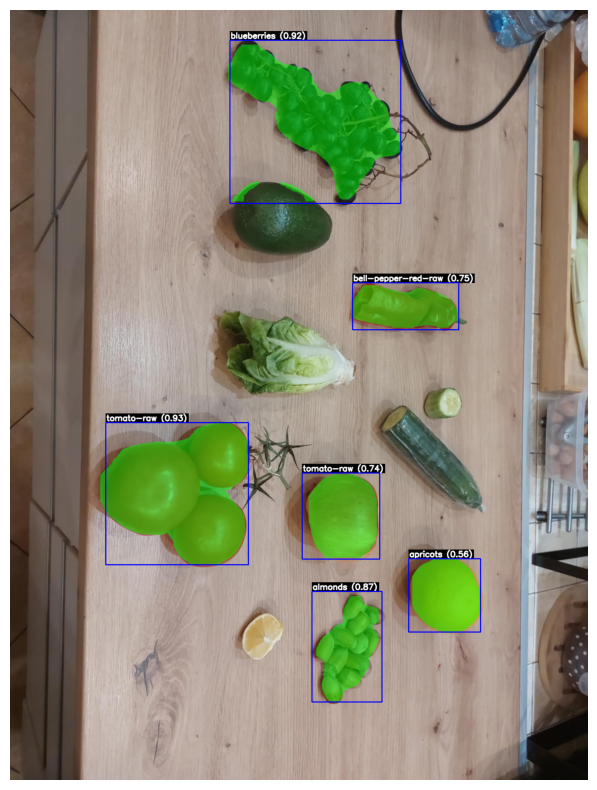

Processing image: test_pics/dom/grapes.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


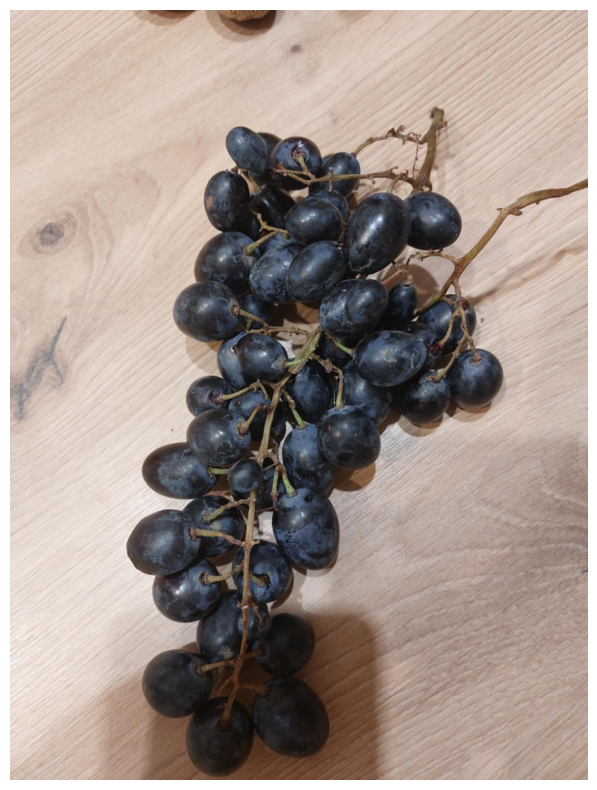

Processing image: test_pics/dom/images.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


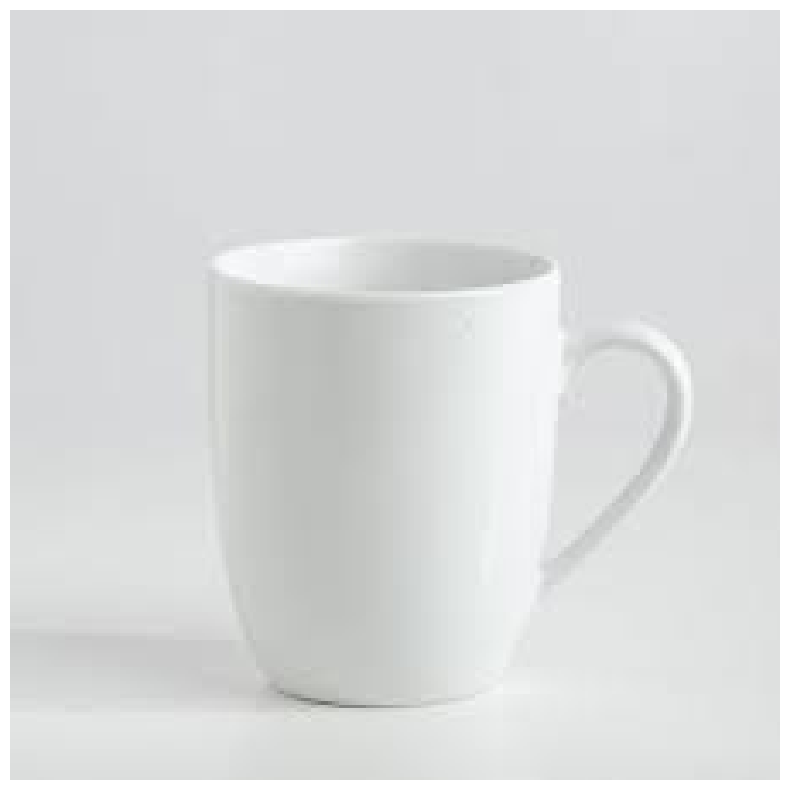

Processing image: test_pics/dom/istockphoto-530813862-170667a.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'black-olives (0.48)', Segmented Class: 'black-olives' with confidence 0.93


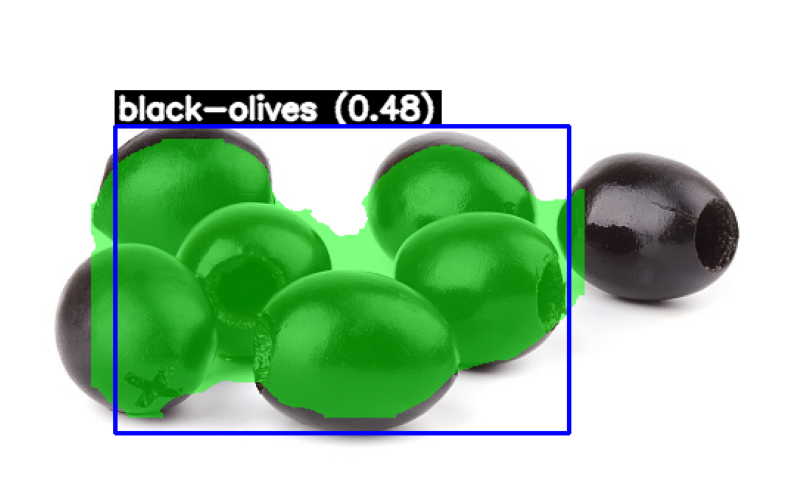

Processing image: test_pics/dom/jaja.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'egg (0.84)', Segmented Class: 'egg' with confidence 0.92
Detected class: 'egg (0.70)', Segmented Class: 'egg' with confidence 0.91


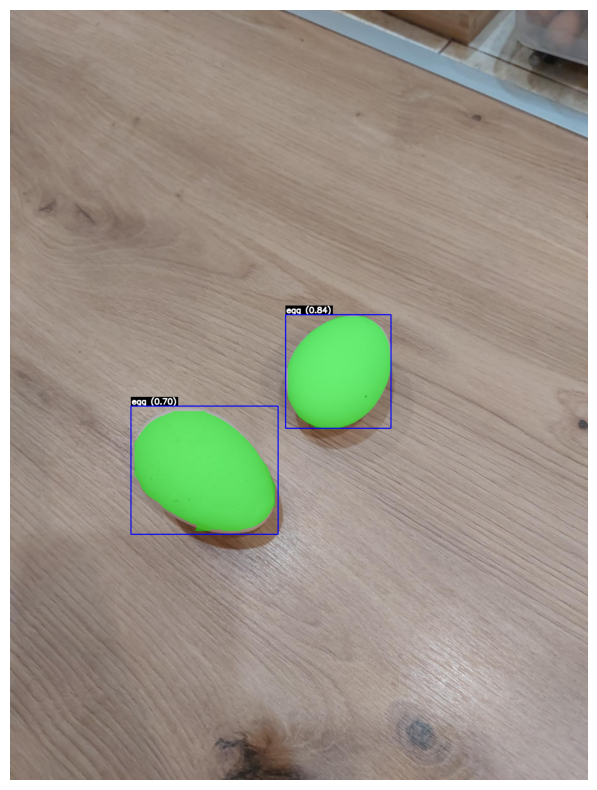

Processing image: test_pics/dom/jajaduzo.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'egg (0.73)', Segmented Class: 'egg' with confidence 0.80
Detected class: 'egg (0.73)', Segmented Class: 'egg' with confidence 0.70
Detected class: 'egg (0.73)', Segmented Class: 'egg' with confidence 0.57
Detected class: 'egg (0.68)', Segmented Class: 'egg' with confidence 0.89
Detected class: 'egg (0.61)', Segmented Class: 'egg' with confidence 0.94
Detected class: 'egg (0.36)', Segmented Class: 'egg' with confidence 0.57
Detected class: 'egg (0.36)', Segmented Class: 'egg' with confidence 0.55


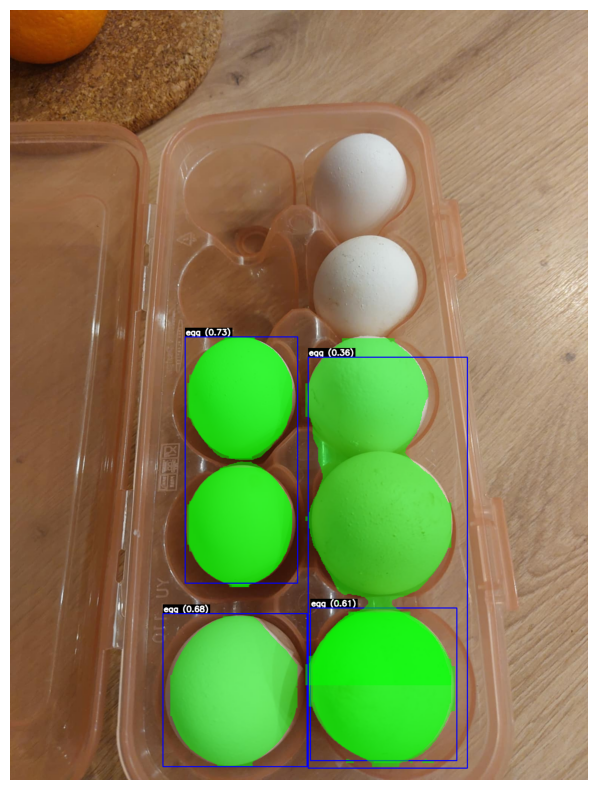

Processing image: test_pics/dom/jajo.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'egg (0.84)', Segmented Class: 'egg' with confidence 0.92


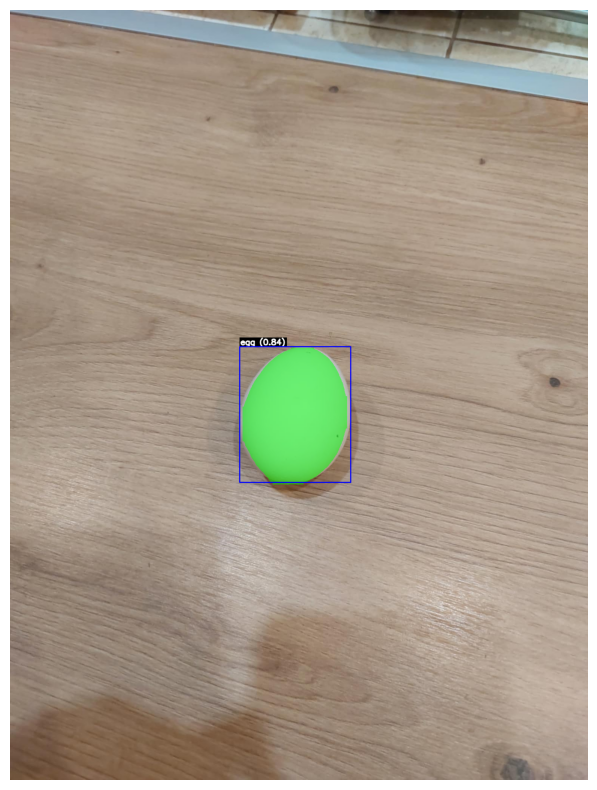

Processing image: test_pics/dom/kiszone.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'cucumber-pickled (0.96)', Segmented Class: 'cucumber' with confidence 0.58


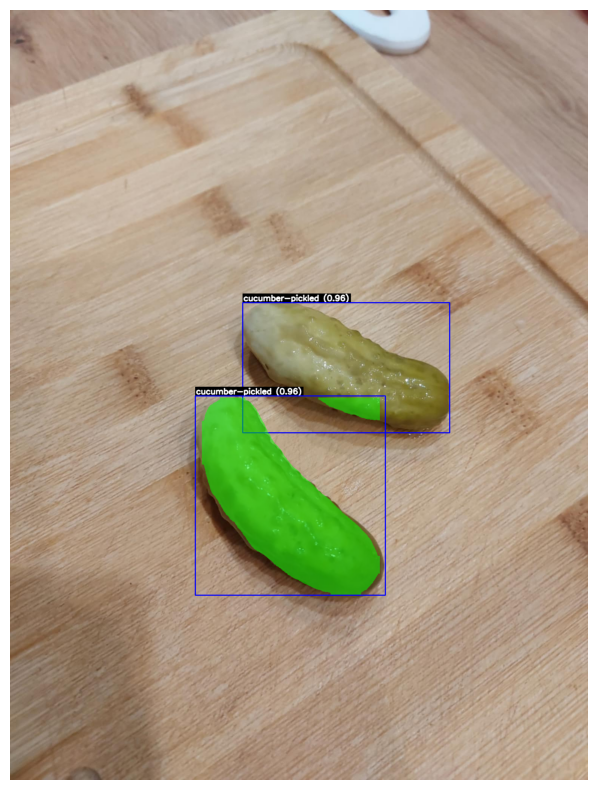

Processing image: test_pics/dom/kotlety.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


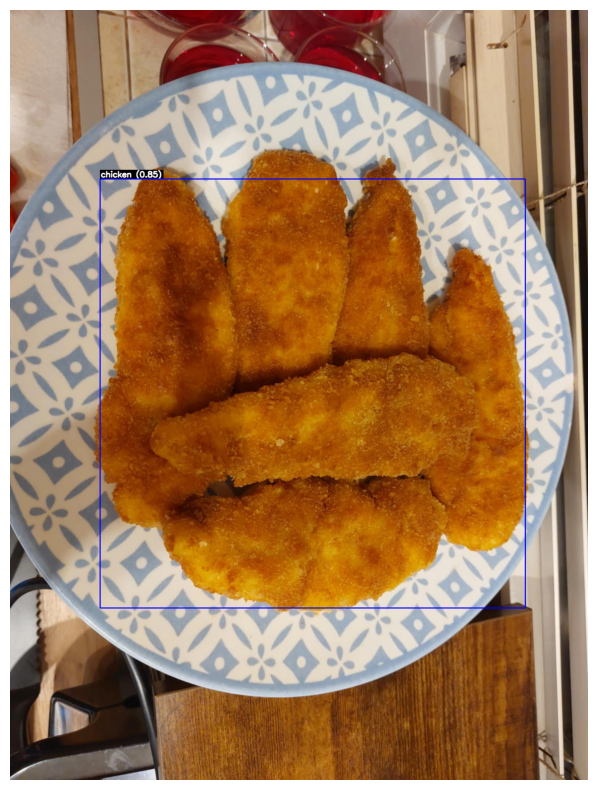

Processing image: test_pics/dom/lettuce.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


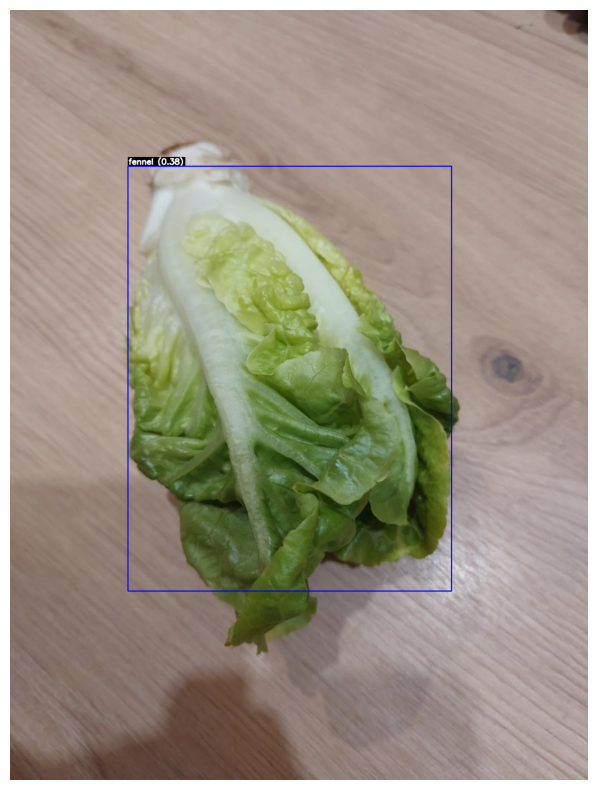

Processing image: test_pics/dom/nut.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'almonds (0.51)', Segmented Class: 'almonds' with confidence 0.55


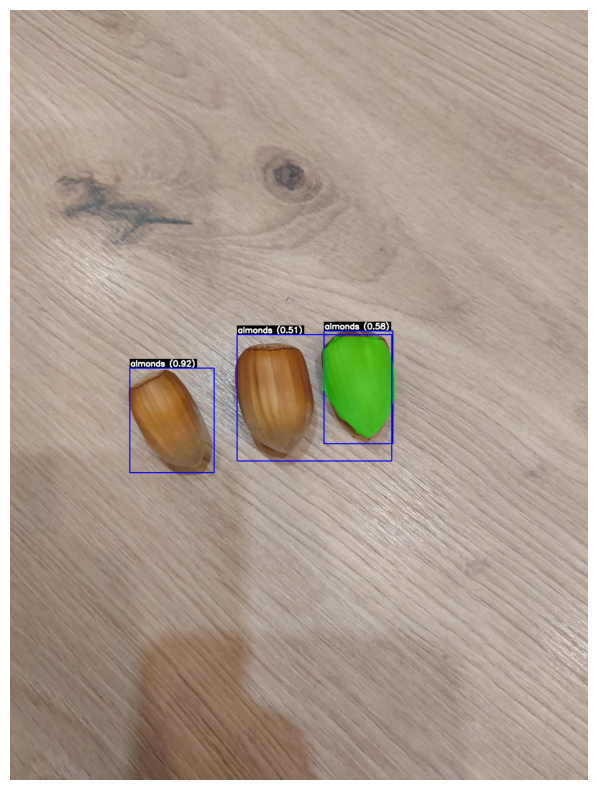

Processing image: test_pics/dom/nut2.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


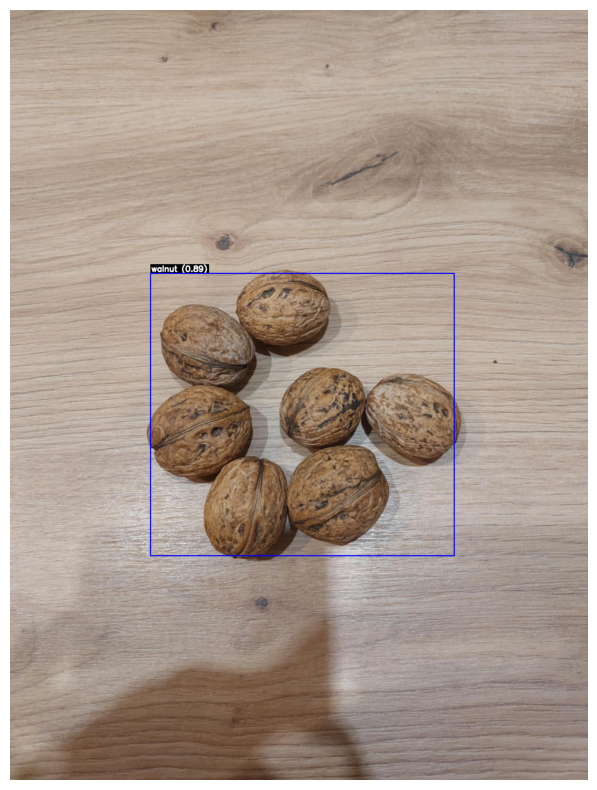

Processing image: test_pics/dom/obiad1.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


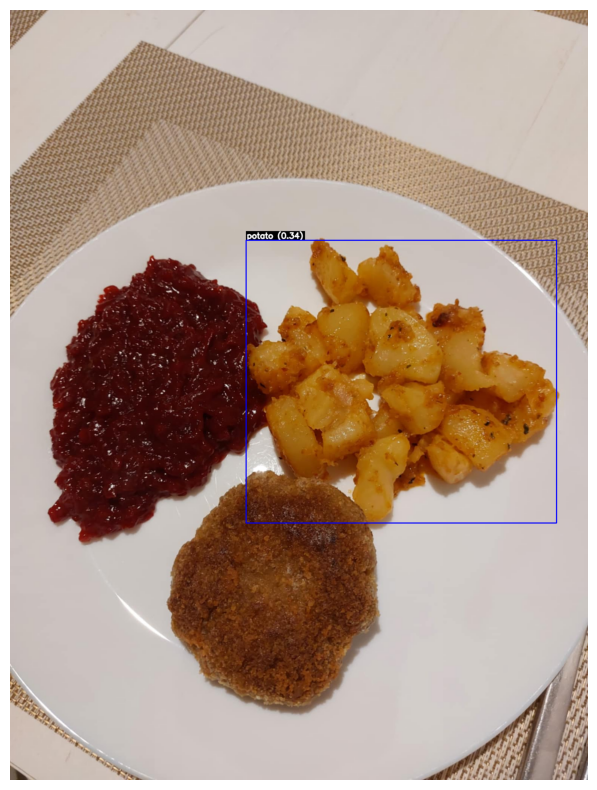

Processing image: test_pics/dom/olives.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


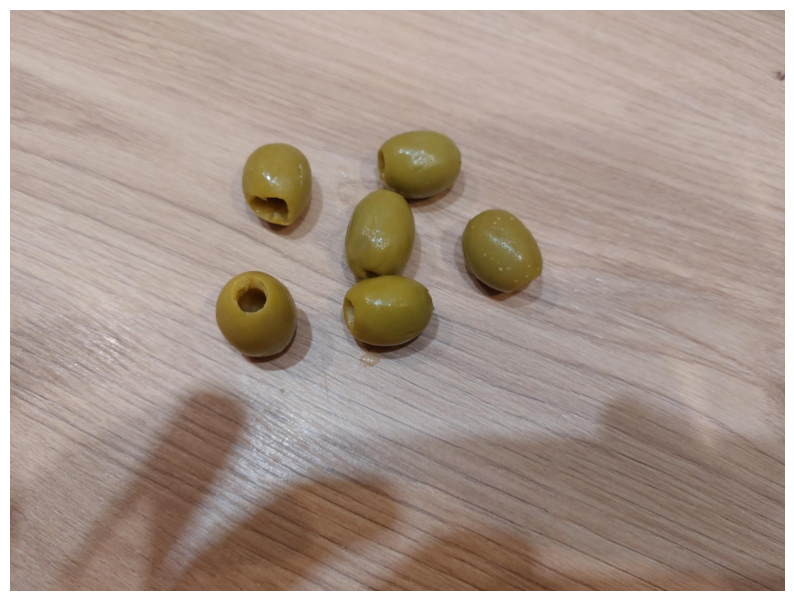

Processing image: test_pics/dom/onion.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


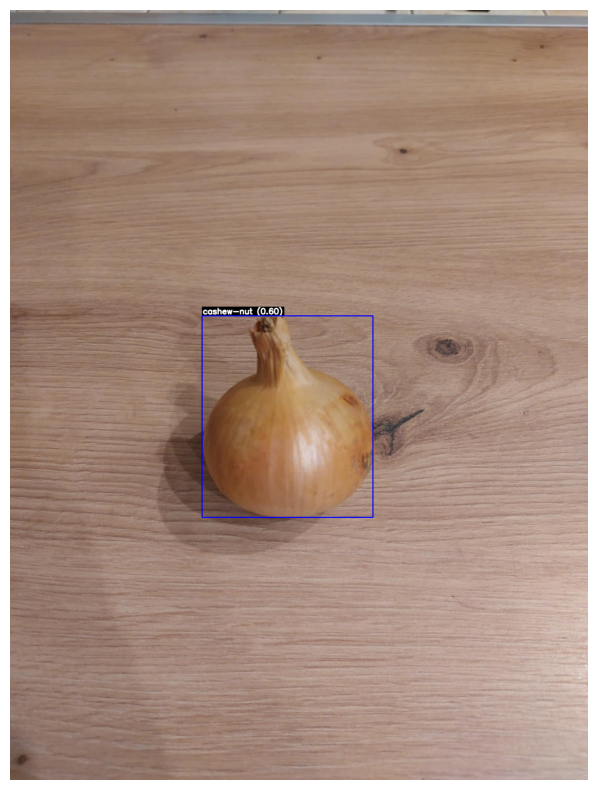

Processing image: test_pics/dom/onion2.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'egg (0.92)', Segmented Class: 'egg' with confidence 0.88


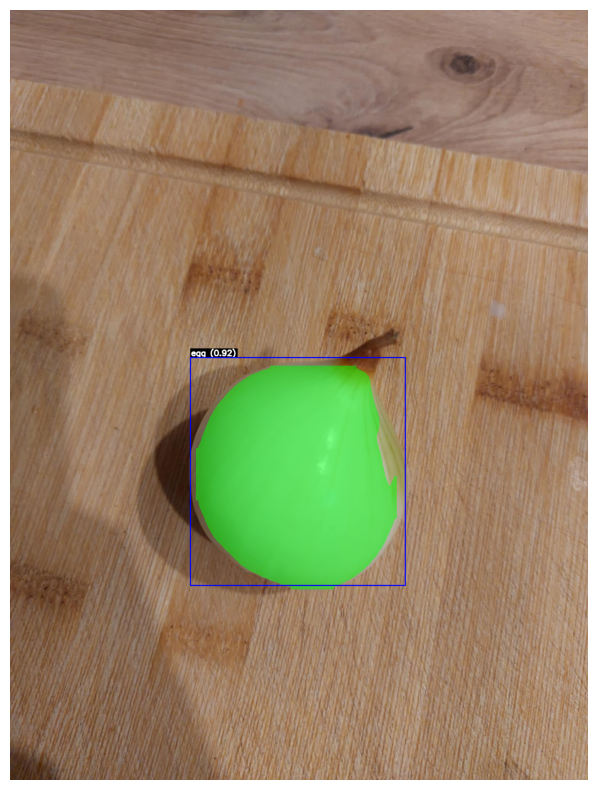

Processing image: test_pics/dom/orange.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'mandarine (0.97)', Segmented Class: 'orange' with confidence 0.93


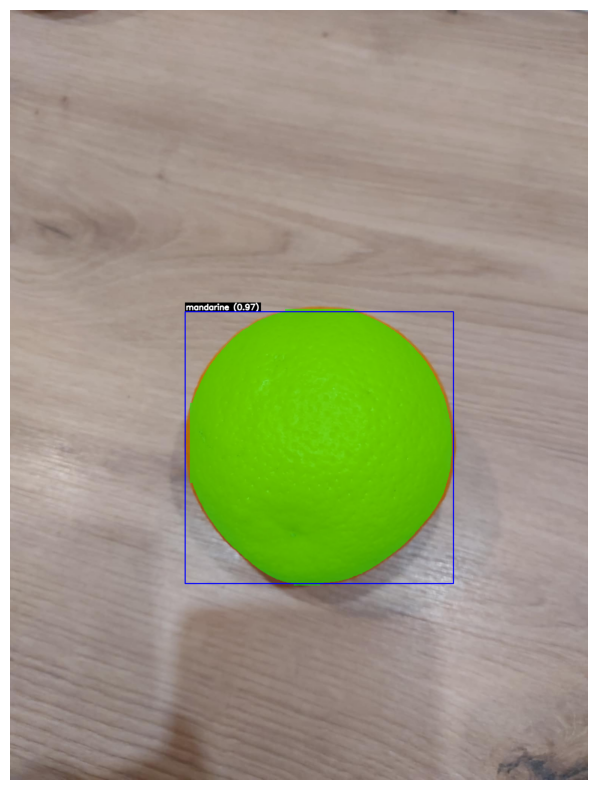

Processing image: test_pics/dom/pepper.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'bell-pepper-red-raw (0.46)', Segmented Class: 'bell-pepper-red-raw' with confidence 0.90
Detected class: 'bell-pepper-red-raw (0.39)', Segmented Class: 'tomato-raw' with confidence 0.80


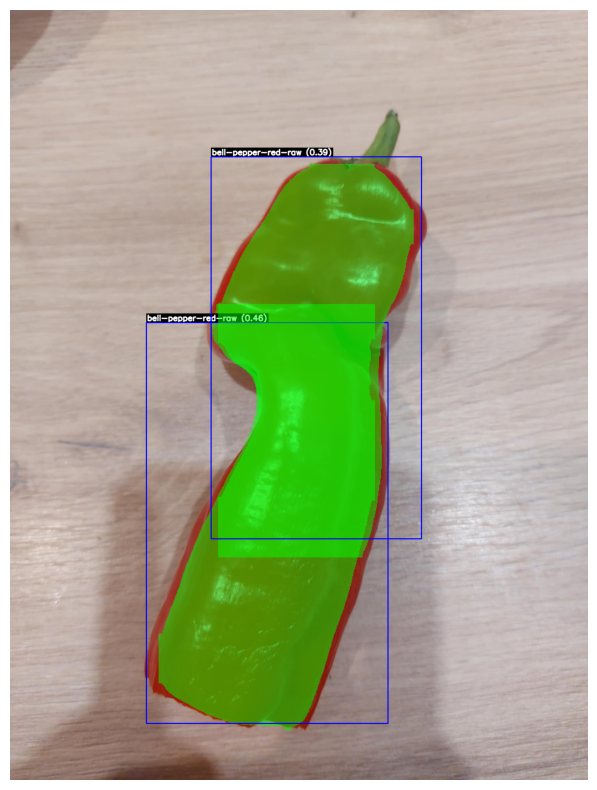

Processing image: test_pics/dom/pizza_ham.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'ham (0.74)', Segmented Class: 'ham' with confidence 0.72
Detected class: 'ham (0.74)', Segmented Class: 'ham' with confidence 0.55
Detected class: 'ham (0.74)', Segmented Class: 'ham' with confidence 0.55
Detected class: 'bacon-frying (0.57)', Segmented Class: 'ham' with confidence 0.91
Detected class: 'ham (0.40)', Segmented Class: 'ham' with confidence 0.56


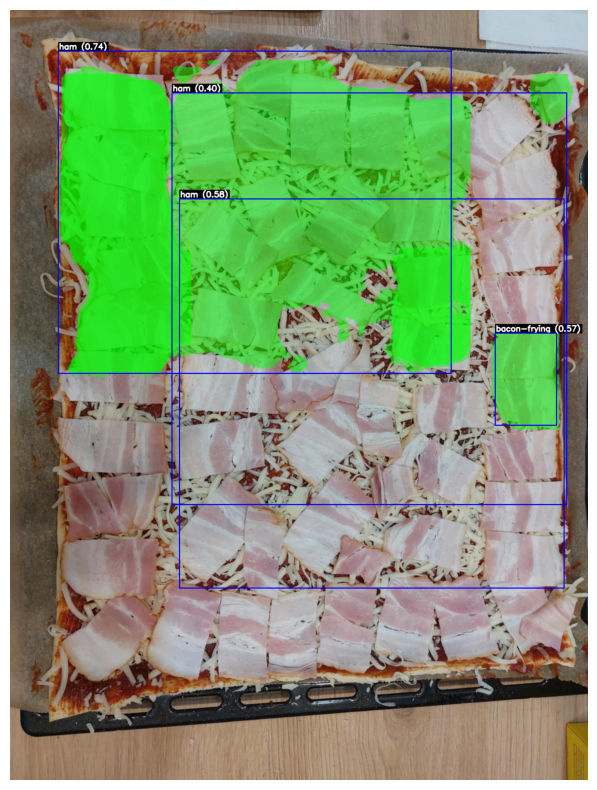

Processing image: test_pics/dom/pizza_ingr.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'broccoli (0.95)', Segmented Class: 'broccoli' with confidence 0.84


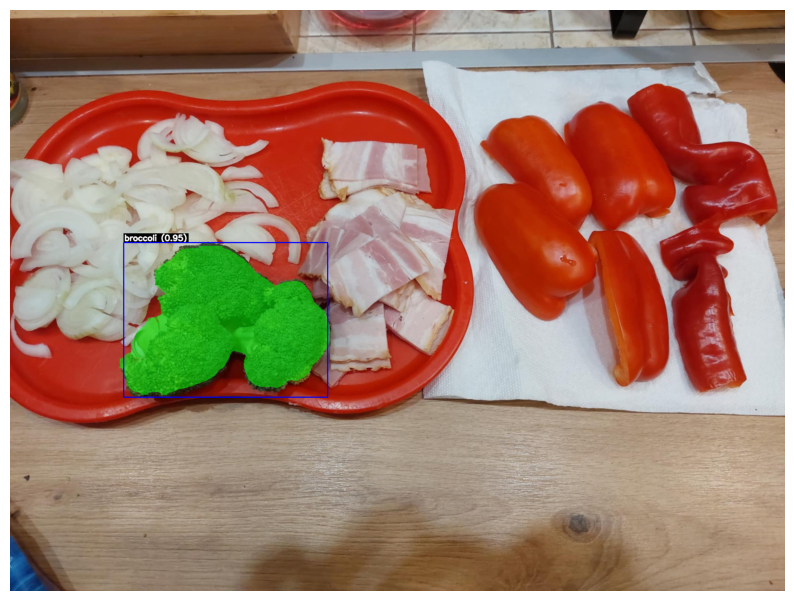

Processing image: test_pics/dom/pizza_post.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'pizza-with-vegetables-baked (0.80)', Segmented Class: 'pizza-with-vegetables-baked' with confidence 0.78


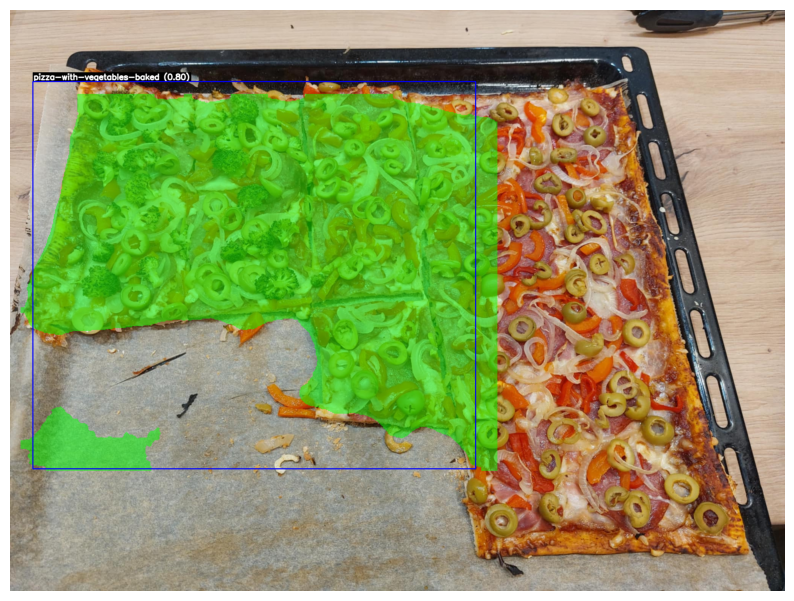

Processing image: test_pics/dom/pizza_pre.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'pizza-margherita-baked (0.53)', Segmented Class: 'pizza-margherita-baked' with confidence 0.76


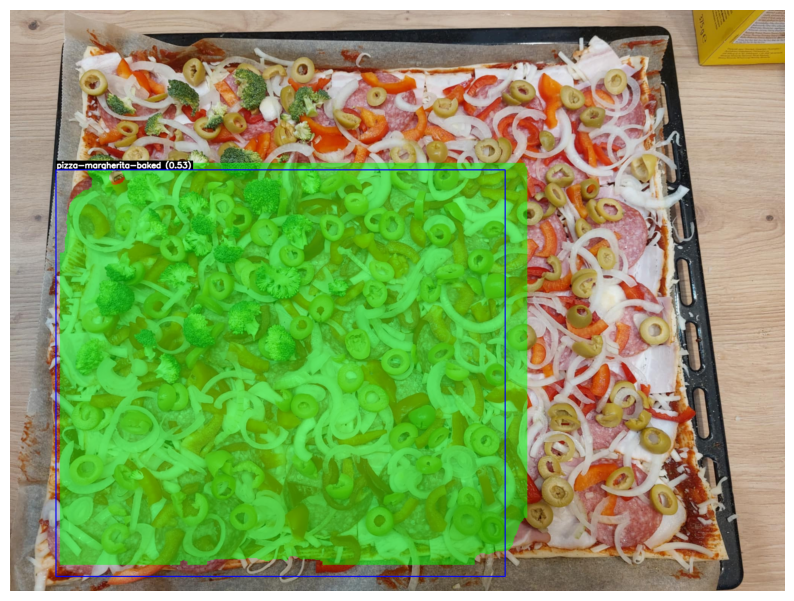

Processing image: test_pics/dom/pizza_slices.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'mixed-vegetables (0.72)', Segmented Class: 'mixed-vegetables' with confidence 0.70


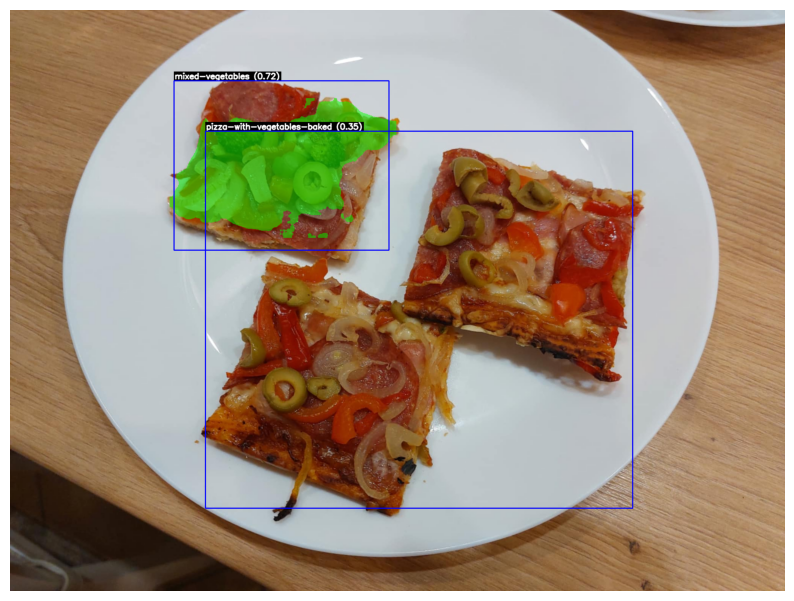

Processing image: test_pics/dom/sandwich.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]
Detected class: 'white-bread (0.91)', Segmented Class: 'bread-white' with confidence 0.92
Detected class: 'ham (0.55)', Segmented Class: 'ham' with confidence 0.69


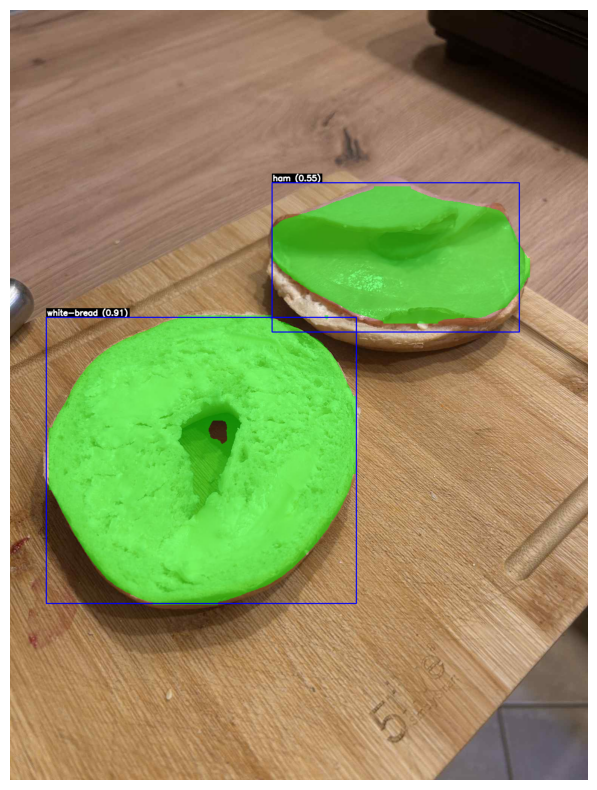

Processing image: test_pics/dom/winogrona.jpg
WARNING imgsz=[1200] must be multiple of max stride 32, updating to [1216]


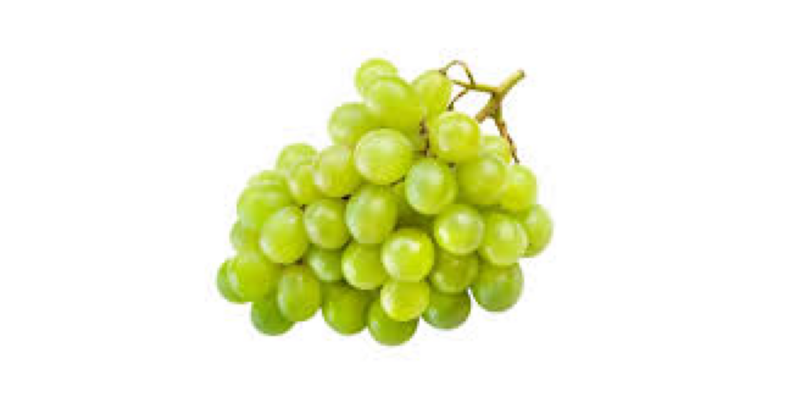

In [3]:
%matplotlib inline
import os

dom_images_path = "test_pics/dom/"

for img_file in os.listdir(dom_images_path):
    if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(dom_images_path, img_file)
        print(f"Processing image: {img_path}")
        results = pipeline.run(image_path=img_path, conf_thresh=0.33, mask_conf_thresh=0.5, det_imgsz=1200, vis=True, vis_crops=False, seg_first=False)


Processing image: test_pics/meat/360_F_221036673_HpCaEoLfDQZbvLY13xjimZq7pJH7S5Ja.jpg
Detected class: 'salami (0.96)', Segmented Class: 'salami' with confidence 0.82
Detected class: 'salami (0.91)', Segmented Class: 'salami' with confidence 0.79
Detected class: 'salami (0.75)', Segmented Class: 'salami' with confidence 0.65
Detected class: 'salami (0.45)', Segmented Class: 'salami' with confidence 0.58
Detected class: 'salami (0.44)', Segmented Class: 'salami' with confidence 0.90


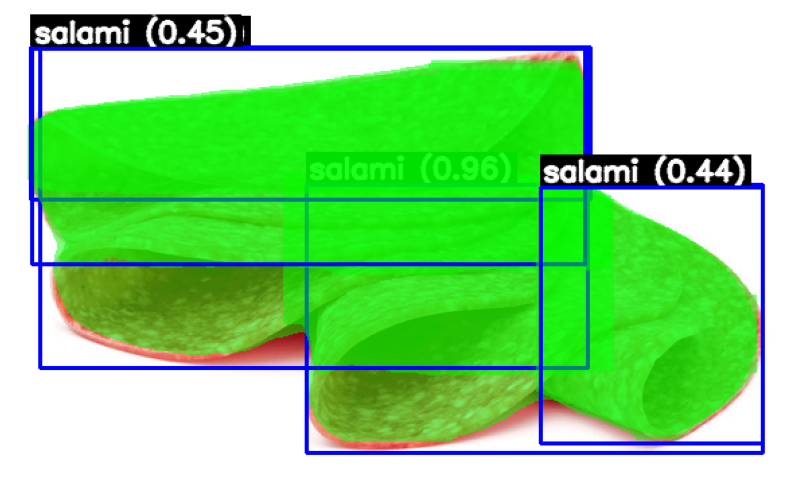

Processing image: test_pics/meat/360_F_228582507_4gLh02T7iKBnMh396FYkpwln9eujh4Mc.jpg
Detected class: 'beef (0.44)', Segmented Class: 'steak' with confidence 0.61


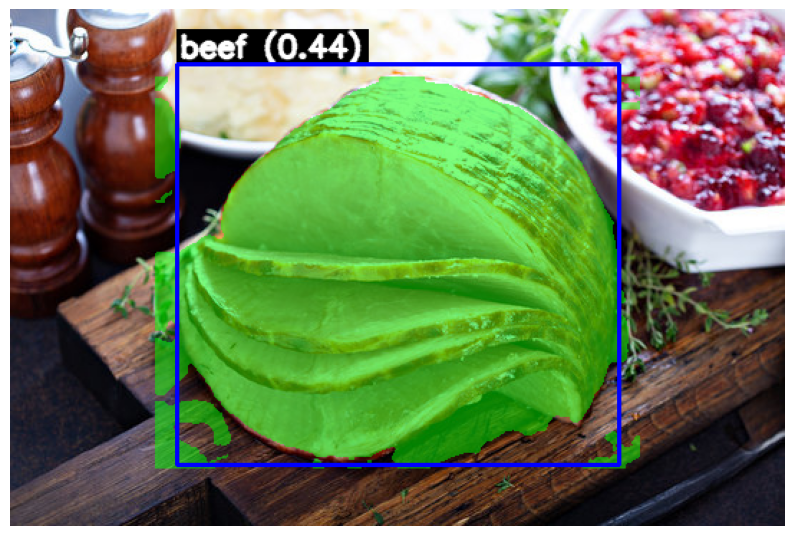

Processing image: test_pics/meat/360_F_49703247_zv2w6hJZysp0QOsObunN2hP4yDvjs9ri.jpg
Detected class: 'bacon-frying (0.89)', Segmented Class: 'steak' with confidence 0.51


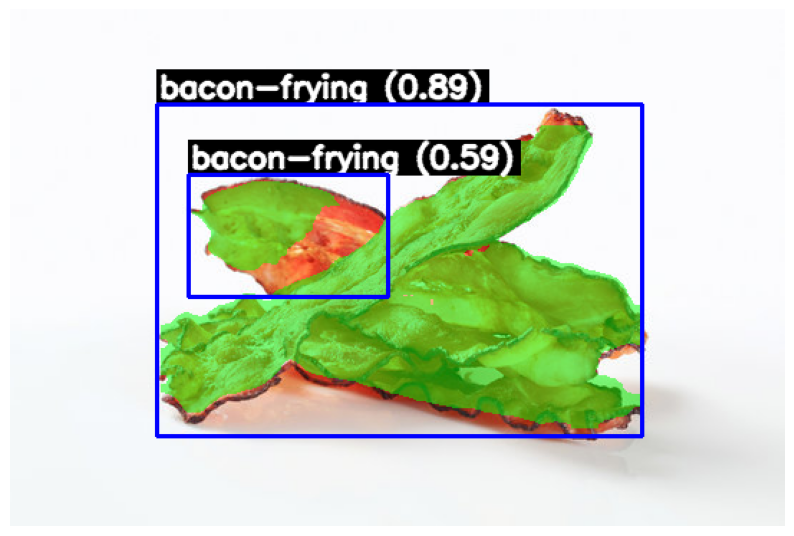

Processing image: test_pics/meat/360_F_613690903_mFjel8Xo2xpDLo3bDYucskPSu6RTa1YC.jpg
Detected class: 'bacon-frying (0.90)', Segmented Class: 'ham-raw' with confidence 0.72
Detected class: 'bacon-frying (0.90)', Segmented Class: 'ham-raw' with confidence 0.66
Detected class: 'bacon-frying (0.56)', Segmented Class: 'ham-raw' with confidence 0.77


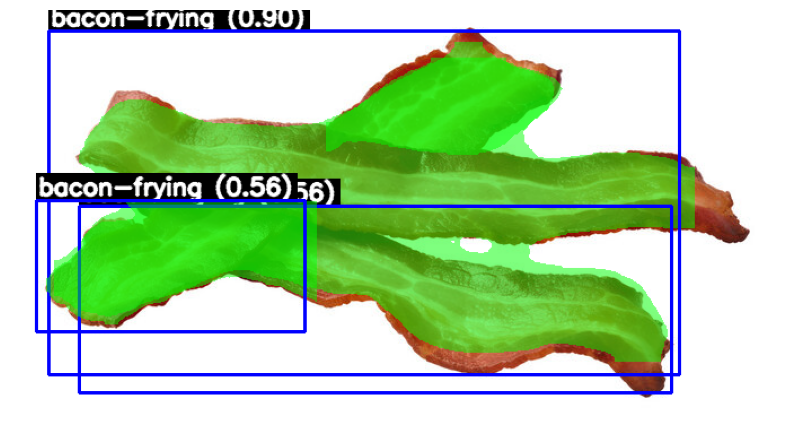

Processing image: test_pics/meat/39c4d11d-9953-4b47-b847-6358dbb307cb.jpg
Detected class: 'bacon-frying (0.86)', Segmented Class: 'ham-raw' with confidence 0.81


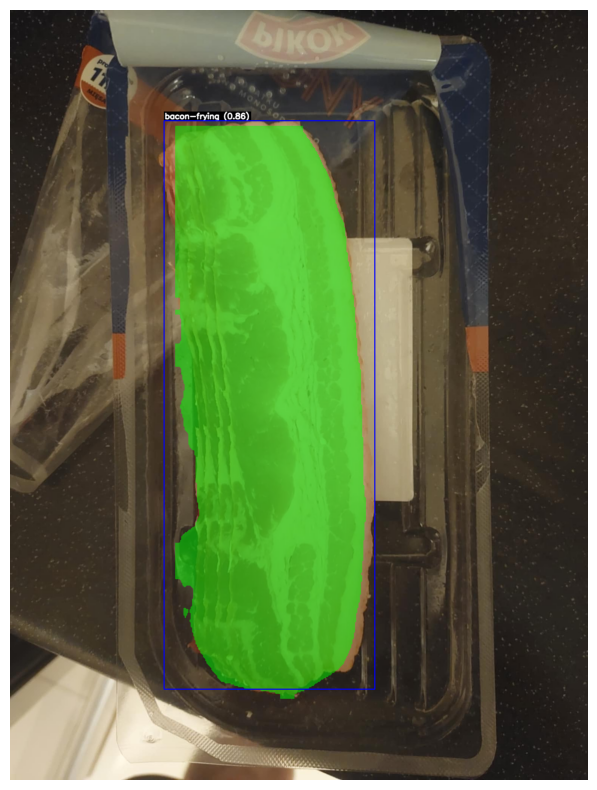

Processing image: test_pics/meat/download (1).jpg


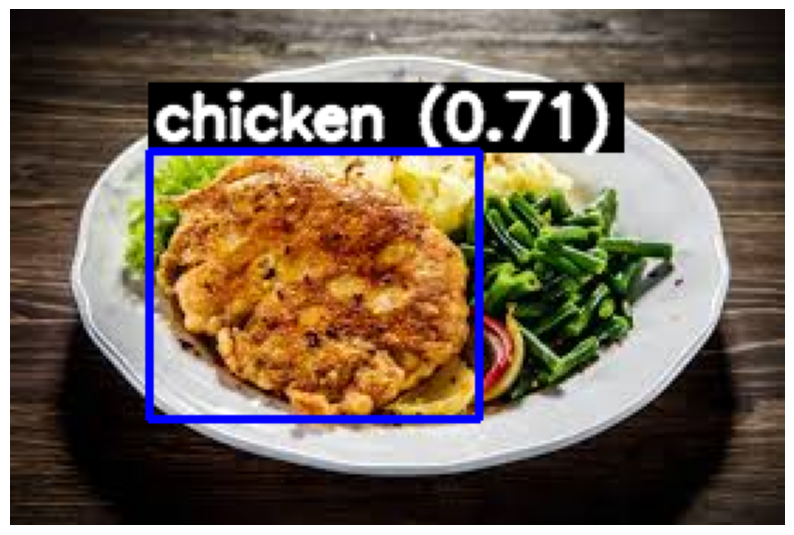

Processing image: test_pics/meat/download.jpg


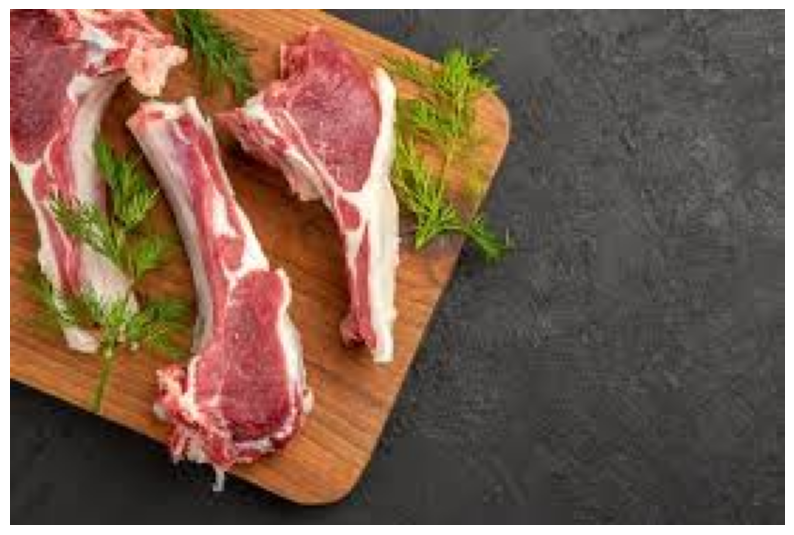

Processing image: test_pics/meat/homemade-turkey-ham-5-500x500.jpg


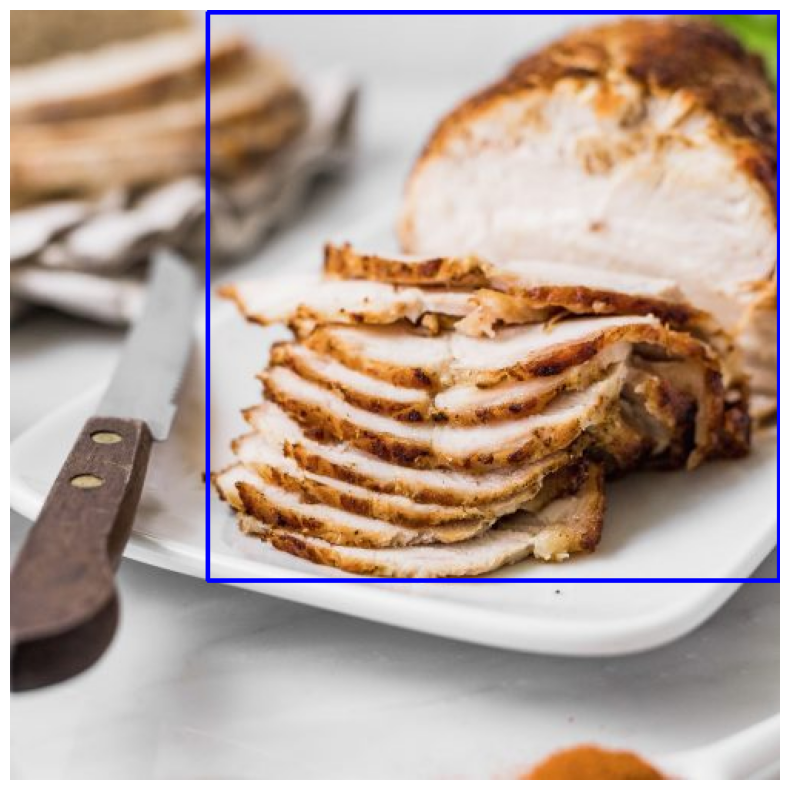

Processing image: test_pics/meat/images.jpg
Detected class: 'sausage (0.93)', Segmented Class: 'ham' with confidence 0.65
Detected class: 'ham (0.83)', Segmented Class: 'ham' with confidence 0.71


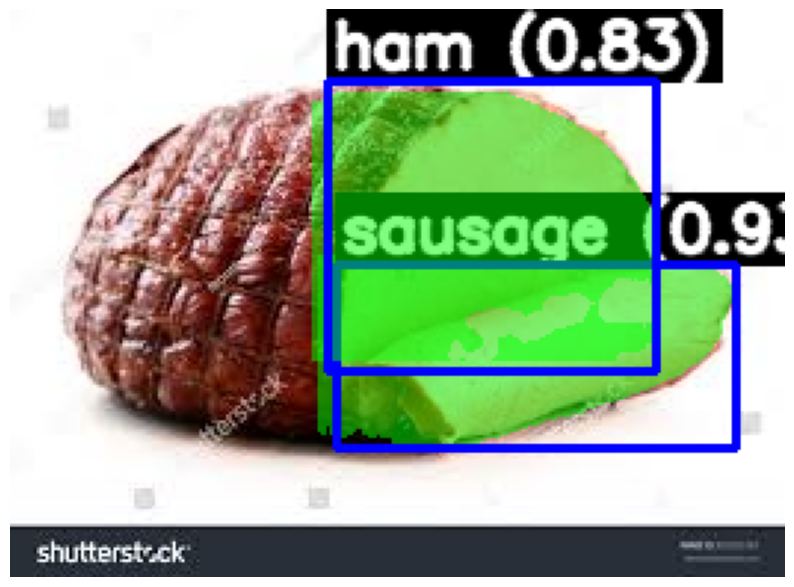

Processing image: test_pics/meat/istockphoto-1143816283-612x612.jpg
Detected class: 'beef (0.72)', Segmented Class: 'steak' with confidence 0.77


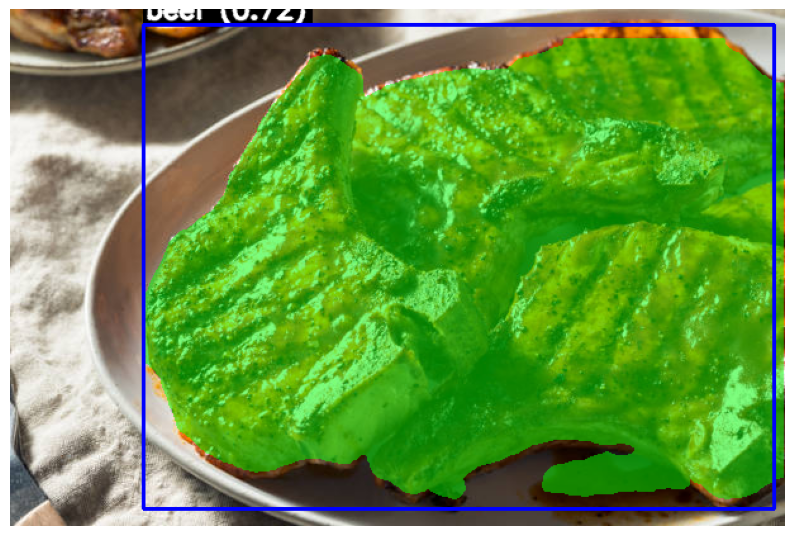

Processing image: test_pics/meat/istockphoto-181503844-612x612.jpg
Detected class: 'salami (0.93)', Segmented Class: 'salami' with confidence 0.78
Detected class: 'salami (0.93)', Segmented Class: 'salami' with confidence 0.59


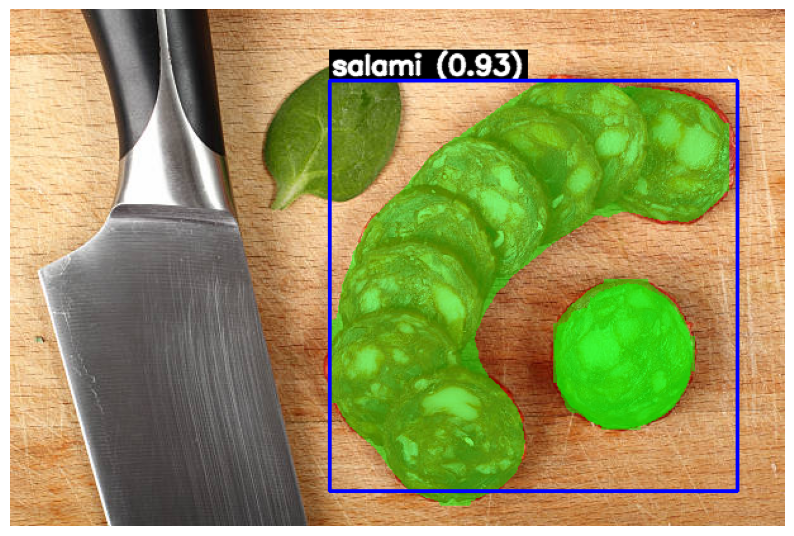

Processing image: test_pics/meat/istockphoto-467413730-612x612.jpg
Detected class: 'beef (0.95)', Segmented Class: 'steak' with confidence 0.71


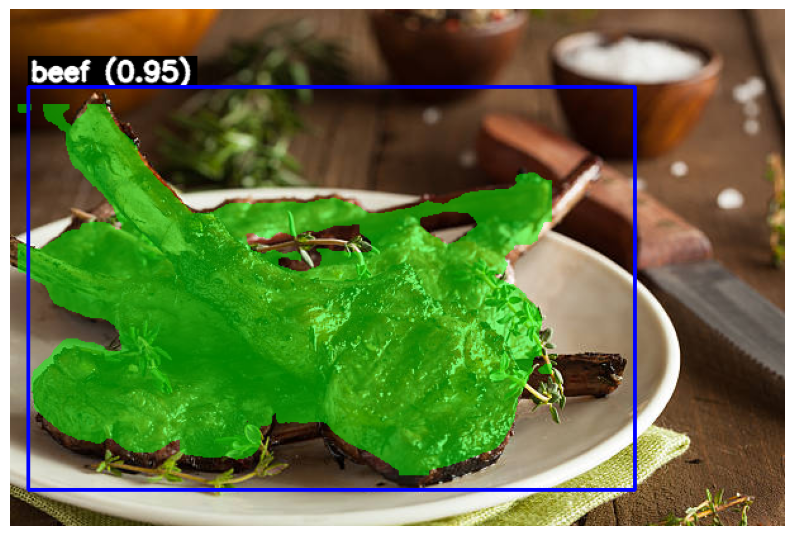

Processing image: test_pics/meat/pexels-pixabay-60616.jpg
Detected class: 'lettuce (0.90)', Segmented Class: 'lettuce' with confidence 0.86
Detected class: 'lettuce (0.90)', Segmented Class: 'lettuce' with confidence 0.53


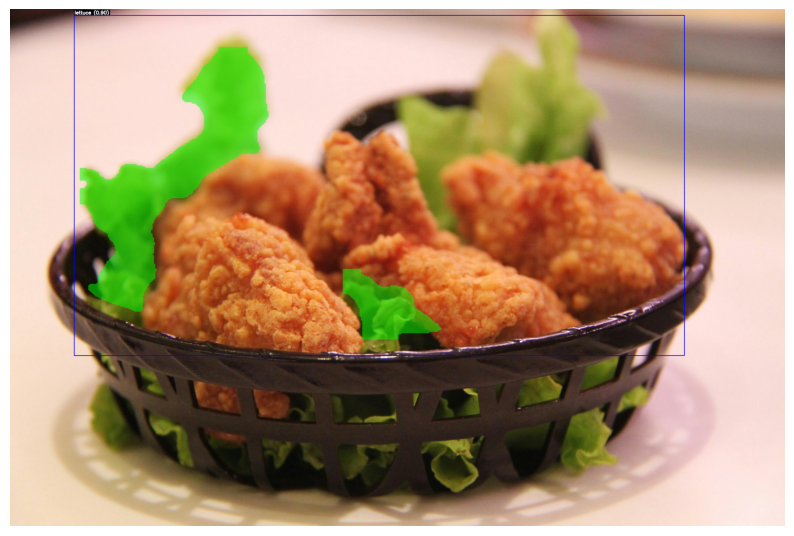

In [4]:
%matplotlib inline
import os

dom_images_path = "test_pics/meat/"

for img_file in os.listdir(dom_images_path):
    if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(dom_images_path, img_file)
        print(f"Processing image: {img_path}")
        results = pipeline.run(image_path=img_path, conf_thresh=0.3, mask_conf_thresh=0.5, vis=True, vis_crops=False)
